# Examples

We'll watch coastline movement from [longshore drift](https://en.wikipedia.org/wiki/Longshore_drift) on [Cape Cod](https://www.google.com/maps/place/Chatham,+MA/@41.7498076,-70.2026227,10.73z/data=!4m13!1m7!3m6!1s0x89fb15440149e94d:0x1f9c0efa001cb20b!2sCape+Cod!3b1!8m2!3d41.6687897!4d-70.2962408!3m4!1s0x89fb142168afbe53:0x714436ec7d485a53!8m2!3d41.6821432!4d-69.9597359), Massachusetts, USA.

We'll make quarterly, cloud-free-ish composites of Sentinel-2 imagery from AWS. Then turn them into GIFs.

In [1]:
import pystac_client
import stackstac
import dask.array as da
import distributed
from geogif import gif, dgif

Launch a local Dask cluster. (This would be much faster with a cluster in the cloud, FWIW.)

In [2]:
client = distributed.Client()

Search for STAC items overlapping our area of interest, from AWS's open data catalog.

In [3]:
bbox = (-70.05487089045347, 41.59659777453696, -69.8481905926019, 41.69921590764708)

In [4]:
%%time
items = (
    pystac_client.Client.open("https://earth-search.aws.element84.com/v1")
    .search(
        bbox=bbox,
        collections=["sentinel-2-l2a"],
        datetime="2018-01-01/2024-01-01",
    )
).item_collection()

CPU times: user 1.41 s, sys: 167 ms, total: 1.57 s
Wall time: 5.9 s


## Make quarterly median composites

Turn STAC items into xarray as a temporal stack, using [stackstac](https://stackstac.readthedocs.io/).

Then mask out bad (cloudy) pixels, according to the Sentinel-2 SCL Scene Classification Map, and take the temporal median of each quarter (three months) to hopefully get an okay-looking cloud-free frame representative of those three months.

Each 3-month composite will be one frame in our animation. We end up with 18 frames.

In [5]:
stack = stackstac.stack(items, bounds_latlon=bbox, resolution=30)

scl = stack.sel(band=["scl"])
# Sentinel-2 Scene Classification Map: nodata, saturated/defective, dark, cloud shadow, cloud med. prob., cloud high prob., cirrus
invalid = da.isin(scl, [0, 1, 2, 3, 8, 9, 10])
valid = stack.where(~invalid)

rgb = valid.sel(band=["red", "green", "blue"])

quarterly = rgb.resample(time="Q").median()
quarterly

<xarray.DataArray 'stackstac-706a4f359b3be98237baef766ab69231' (time: 24,
                                                                band: 3,
                                                                y: 387, x: 579)>
dask.array<stack, shape=(24, 3, 387, 579), dtype=float64, chunksize=(1, 1, 387, 579), chunktype=numpy.ndarray>
Coordinates: (12/21)
  * time                                     (time) datetime64[ns] 2018-03-31...
  * band                                     (band) <U12 'red' 'green' 'blue'
  * x                                        (x) float64 4.121e+05 ... 4.294e+05
  * y                                        (y) float64 4.617e+06 ... 4.605e+06
    mgrs:utm_zone                            int64 19
    proj:epsg                                int64 32619
    ...                                       ...
    raster:bands                             (band) object None None None
    gsd                                      (band) object 10 10 10
    common_name                              (band) object 'red' 'green' 'blue'
    center_wavelength                        (band) object 0.665 0.56 0.49
    full_width_half_max                      (band) object 0.038 0.045 0.098
    epsg                                     int64 32619

Use `.persist()` to start the computation (which takes ~5min on my home internet connection, downloading ~2.5gb of data), then hold the pre-computed composites in the cluster's memory. We're going to reuse the same composites a few times, so it makes sense to persist it.

In [6]:
ts = quarterly.persist()

## Quick filmstrip of all the frames, to see what we're dealing with

We're just showing it here for comparison to the animations.

This is actually slower than computing a GIF itself, especially if you use a remote cluster, since you have to download the full-bit-depth data from the cluster. On a cluster running in the cloud close to the imagery data, transferring this full array data can take longer than the computation itself, depending on your internet speeds.

In [7]:
ts_local = ts.compute()

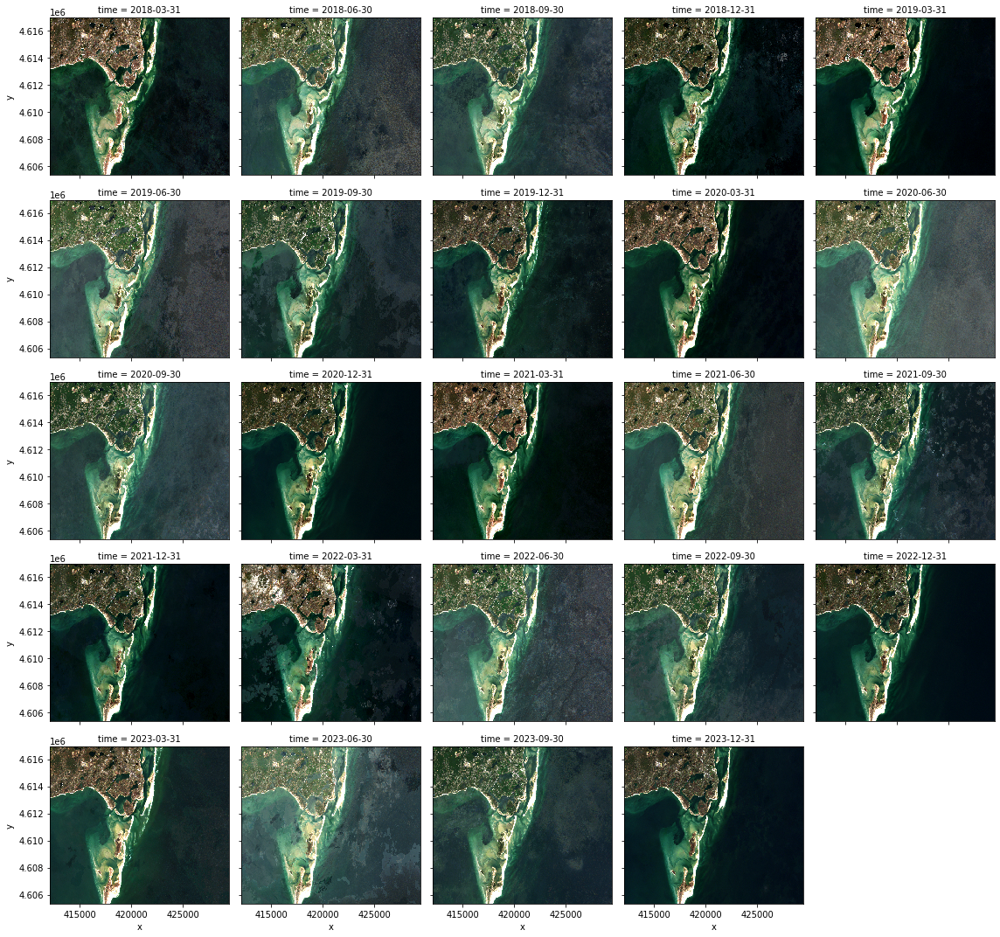

In [8]:
ts_local.plot.imshow(col="time", rgb="band", col_wrap=5, robust=True)

## Clean up NaNs

Forward-fill, the backwards-fill the NaNs, to make a smoother-looking animation. (Note that this requires [Bottleneck](https://github.com/pydata/bottleneck).)

In [9]:
cleaned = ts.ffill("time").bfill("time")

## Make GIFs!

### Defaults

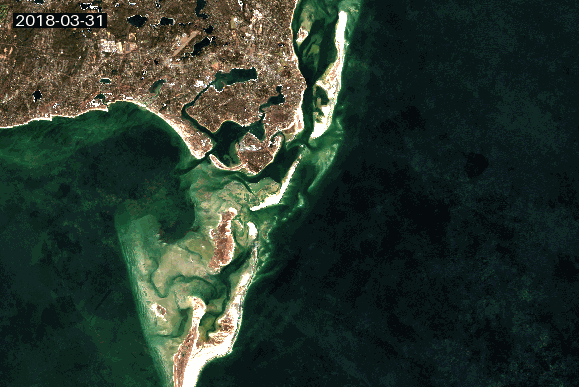

In [10]:
dgif(cleaned).compute()

### No timestamp

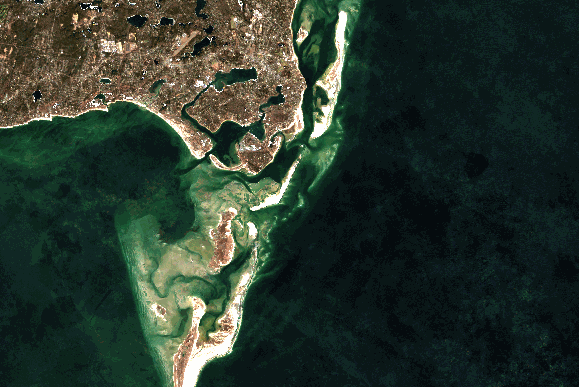

In [11]:
dgif(cleaned, date_format=None).compute()

### Big timestamp

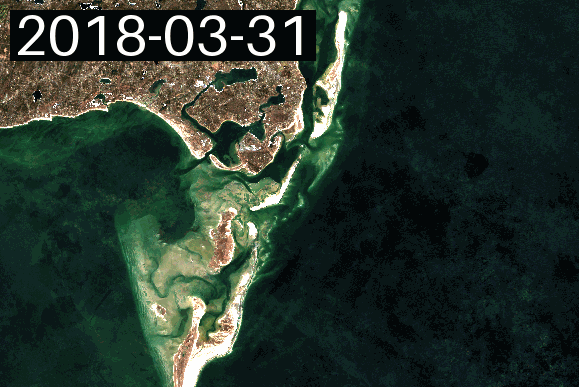

In [12]:
dgif(cleaned, date_size=0.5).compute()

### S L O W M O T I O N

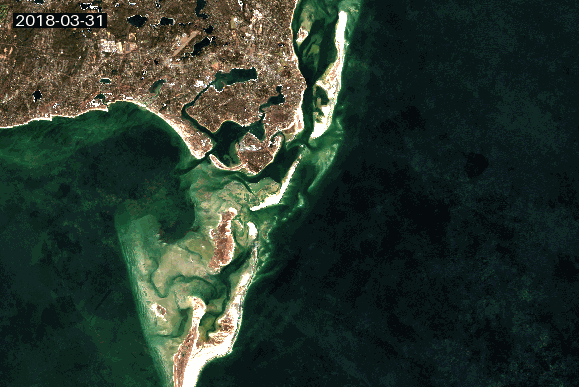

In [13]:
dgif(cleaned, fps=5).compute()

### `gif` (non-Dask)

`gif` and `dgif` behave the same. `dgif(x).compute()` is usually faster than `gif(x.compute())`.

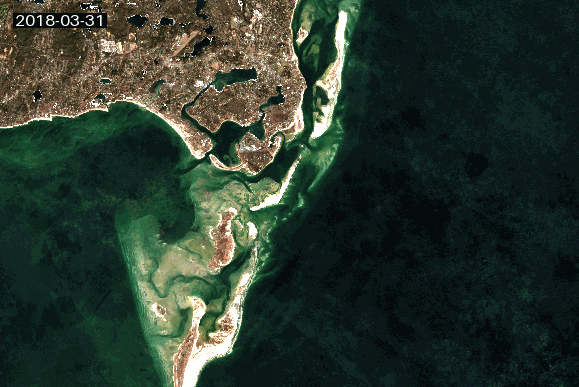

In [14]:
gif(ts_local)

### `gif` to file

In [15]:
gif(ts_local, to="capecod.gif")

### `dgif` to bytes

In [16]:
gif_bytes = dgif(cleaned, bytes=True).compute()

In [17]:
with open("capecod2.gif", "wb") as f:
    f.write(gif_bytes)

### Colormapped (single-band) GIF

We'll demonstrate single-band colormapped GIFs by just looking at the green band.

(Typically, you'd do something more meaningful like a derived index, but green happens to look cool in this example.)

In [18]:
green = ts_local.sel(band='green')

The colormap defaults to viridis

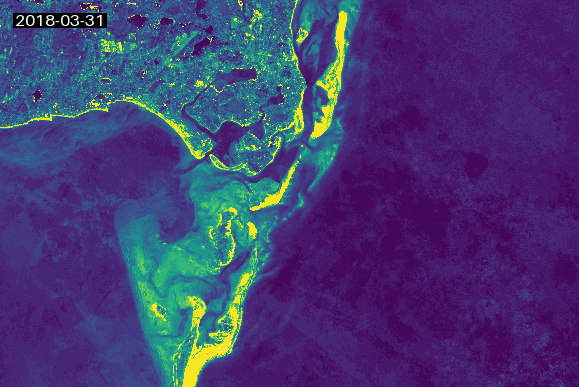

In [19]:
gif(green)

### Pick a colormap

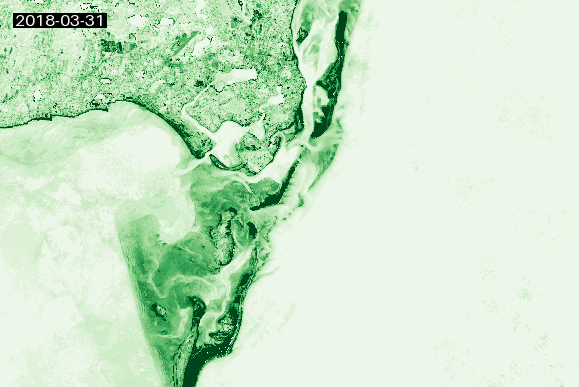

In [20]:
gif(green, cmap="Greens")

### Custom date format and position

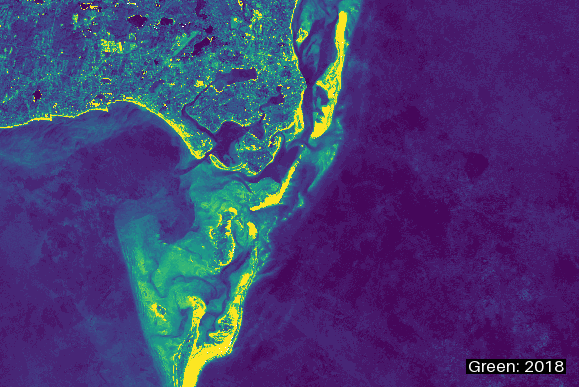

In [21]:
gif(green, date_format="Green: %Y", date_position="lr")

### Custom date color and background

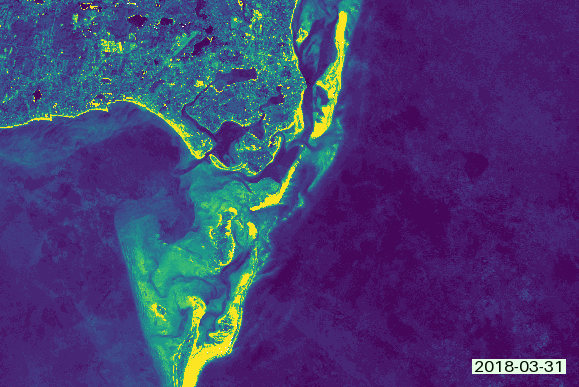

In [22]:
gif(green, date_color=(0, 10, 0), date_bg=(230, 255, 230), date_position="lr")

### Custom date color, no background, absolute font size

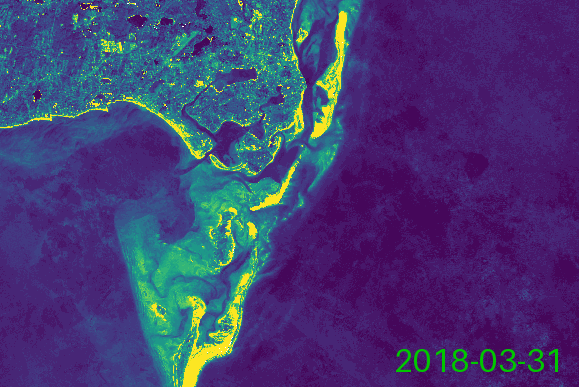

In [23]:
gif(green, date_color=(0, 200, 0), date_bg=None, date_size=32, date_position="lr")